# Sitcom Laughtrack mute tool 
### or *a LSTM network for audio classification*

Jeff Green, 2018

### Summary

A tool to mute laugh tracks from an audio clip without operator intervention.  Implements a recurrent neural network (LSTM network) to classify audio.

Technically, this could be used as a generic two-class audio classifier, but the model is not validated against anything besides laugh audio classification.

### Example Output

See https://youtu.be/DeTQBiKzmYc


### Usage

Given that all of the code in this notebook is loaded, and the trained model saved to 'saved-model.h5', this should work:
```
laughr = LaughRemover(kerasModelFile='saved-model.h5')
laughr.remove_laughs('S05E05-sample3.wav', 'S05E05-sample3-method5a-output.wav')
```

At a future time, I intend to also publish a user-friendly script and pre-trained models.

#### Future Usage
Goal Syntax (doesn't exist yet)
```
# Place sample audio clips in ./training/
#  - d*.wav (dialog or not laugh track clips)
#  - f*.wav (laugh track clips)
# Use a tool like Audacity to simplify this process.

python laughr.py --train ./training/d*.wav ./training/f*.wav
```

Goal Training Syntax (doesn't exist yet)
```
ffmpeg -i video.mp4 audio.wav
python laughr.py --mute-laughs audio.wav audio-nolaughs.wav
ffmpeg -i video.mp4 -i audio-nolaughs.wav -map 0:0 -map 1:0 -c:v copy -c:a aac -b:a 128k -shortest video-nolaughs.mp4
```

### Background

This project started as a dinner conversation - a couple of fans of the TV show Frasier were discussing how interesting it would be to watch the show without the laugh track.

Googling the topic indicated that while across many TV shows of a similar nature, some clips of the show without laugh tracks have been posted on sites such as YouTube, the work is typically done by hand - a manual process of clipping out the audio.

I set out to build an automated tool capable of detecting and muting laugh track audio segments from a source file.  This way, the transformation could be applied to many clips or entire episodes with minimal manual tweaking required.


### Key Points

* The Frasier "laugh track" is highly variable studio audience laugher, and therefore isn't trivially identified or subtracted using existing noise-cancellation methods.

* I observed early on that frequency spectrogram visualizations were easy for a human to classify as "probably laugher"

* Using a time-series approach (LSTM network) was critical to increasing the model's accuracy.  This was a big improvement.

* For each sample, I construct a composite time-series feature array using many of librosa's feature extraction methods, letting the model "choose" which feature functions are most useful for classifying the data.

* Using a rolling window to generate samples from the audio clips.  This was critical to granular accuracy of classification.

* During exploratory data analysis, I used methods such as PCA and K-means clustering on the spectra data but those approaches resulted in only 80-85% accuracy.  

* Other less successful approaches: Simple neural networks (not RNN) to classify the unprocessed audio sample data, dense neural networks to classify the spectra data.  These resulted in only 80-85% accuracy, a significant drop compared to the RNN approach.

### What's Next?

I have some next ideas, listed at the end of the document.


### License

MIT License

Copyright 2018 Jeff Green

Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.

## Method 5a - Feature Extraction and LSTM Classification

In `RawClip3` we generate a time-stepped feature vector using a number of pre-canned features extracted thanks to the Librosa library.  For each audio clip, we create fixed duration sliding windows to provide a consistent time period for analysis.  When later classifying data, we will classify each window as "laughter" or "dialog".

In `DataSet` we load our manually classified audio clips, assigning class based on the filename, and provide methods for sampling random training, cross-validation, and test sets.

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import soundfile as sf
import librosa
import librosa.display
import math
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
def get_friendly_class(y_class):
    if y_class[0] == 1 and y_class[1] == 0:
        return 'Laugh'
    if y_class[0] == 0 and y_class[1] == 1:
        return 'Dialog'

class RawClip3(object):
    featureFuncs = ['tonnetz', 'spectral_rolloff', 'spectral_contrast',
                    'spectral_bandwidth', 'spectral_flatness', 'mfcc',
                    'chroma_cqt', 'chroma_cens', 'melspectrogram']

    def __init__(self, sourcefile, Y_class=None):
        self.y, self.sr = sf.read(sourcefile)
        self.laughs = None
        self.Y_class = Y_class

    def resample(self, rate, channel):
        return librosa.resample(self.y.T[channel], self.sr, rate)

    def amp(self, rate=22050, n_fft=2048, channel=0):
        D = librosa.amplitude_to_db(librosa.magphase(librosa.stft(
            self.resample(rate, channel), n_fft=n_fft))[0], ref=np.max)
        return D

    def _extract_feature(self, func):
        method = getattr(librosa.feature, func)

        # Construct params for each 'class' of features
        params = {'y': self.raw}
        if 'mfcc' in func:
            params['sr'] = self.sr
            params['n_mfcc'] = 128
        if 'chroma' in func:
            params['sr'] = self.sr

        feature = method(**params)

        return feature

    def _split_features_into_windows(self, data, duration):
        # Apply a moving window
        windows = []

        # Pad the rightmost edge by repeating frames, simplifies stretching
        # the model predictions to the original audio later on.
        data = np.pad(data, [[0, duration], [0, 0]], mode='edge')
        for i in range(data.shape[0] - duration):
            windows.append(data[i:i+duration])

        return np.array(windows)

    def build_features(self, duration=30, milSamplesPerChunk=10):
        # Extract features, one chunk at a time (to reduce memory required)
        # Tip: about 65 million samples for a normal-length episode
        # 10 million samples results in around 1.5GB to 2GB memory use
        features = []

        chunkLen = milSamplesPerChunk * 1000000
        numChunks = math.ceil(self.y.shape[0] / chunkLen)

        for i in range(numChunks):
            # Set raw to the current chunk, for _extract_feature
            self.raw = self.y.T[0][i * chunkLen:(i+1)*chunkLen]

            # For this chunk, run all of our feature extraction functions
            # Each returned array is in the shape (features, steps)
            # Use concatenate to combine (allfeatures, steps)
            chunkFeatures = np.concatenate(
                list(
                    map(self._extract_feature, self.featureFuncs)
                    )
                )
            features.append(chunkFeatures)


        # Transform to be consistent with our LSTM expected input
        features = np.concatenate(features, axis=1).T
        # Combine our chunks along the time-step axis.
        features = self._split_features_into_windows(features, duration)

        return features

### Load Training data

Our labelled training examples were created using ffmpeg (to extract .wav from source videos) and Audacity to label the tracks.  After labeling, the Audacity `Export Multiple` option simplified exporting manually labelled sections of dialog and laughter to individual numbered `.wav` files with a consistent prefix:

* ff*.wav - clip of laugher
* dd*.wav - clip of dialog (or other non-laugher audio)

The helper class `DataSet` simplifies loading the labelled clips and randomly sampling into three data sets, 60% training, 20% cross-validation, and 20% test set.

In [3]:
from glob import glob

class DataSet(object):
    def __init__(self, datapath, laughPrefix='/ff*.wav', dialogPrefix='/dd*.wav'):
        self.clips = []
        for y_class, files in [[1., 0.], glob(datapath + laughPrefix)], [[0., 1.], glob(datapath + dialogPrefix)]:
            for ff in files:
                self.clips.append(RawClip3(ff, y_class))
        np.random.seed(seed=0)
        self.X, self.Y_class = self._get_samples()
        self.idx_train, self.idx_cv, self.idx_test = self.split_examples_index(len(self.Y_class))

    def split_examples_index(self, total):
        """Returns shuffled index for 60/20/20 split of train, cv, test"""
        np.random.seed(seed=0)
        idx = np.random.choice(total, size=total, replace=False, )

        #60/20/20 split
        train = idx[0:int(total*0.6)]
        cv    = idx[int(total*0.6):int(total*0.6) + int(total*0.2)]
        test  = idx[int(total*0.8):]

        return train, cv, test

    def _get_samples(self):
        X = []
        y = []
        for clip in self.clips:
            for s in clip.build_features():
                X.append(s)
                y.append(clip.Y_class)
                
        return np.array(X), np.array(y)

In [4]:
ds = DataSet('training/set2/')

In [5]:
ds.X.shape, ds.Y_class.shape

((11245, 30, 296), (11245, 2))

### Classification Model

Using a 3-layer LSTM network with an input normalization layer.

In [6]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, LSTM, Dropout, BatchNormalization

input_shape = ds.X[0].shape

model = Sequential()
model.add(BatchNormalization(input_shape=input_shape))
model.add(LSTM(64, return_sequences=True))
model.add(LSTM(64, return_sequences=True))
model.add(LSTM(64))
model.add(Dropout(0.2))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['accuracy'])

Using TensorFlow backend.


In [7]:
result = model.fit(ds.X[ds.idx_train], ds.Y_class[ds.idx_train], epochs=4, batch_size=16, verbose=2)

Epoch 1/4
 - 14s - loss: 0.0185 - acc: 0.9936
Epoch 2/4
 - 13s - loss: 0.0041 - acc: 0.9994
Epoch 3/4
 - 13s - loss: 0.0083 - acc: 0.9994
Epoch 4/4
 - 13s - loss: 0.0043 - acc: 0.9991


In [8]:
model.evaluate(ds.X[ds.idx_cv], ds.Y_class[ds.idx_cv])

2249/2249 [==============================] - 1s 601us/step


[1.2220410092087227e-07, 1.0]

Well, can't complain about those results.

In [9]:
model.evaluate(ds.X[ds.idx_test], ds.Y_class[ds.idx_test])

2249/2249 [==============================] - 1s 534us/step


[2.3796224162111647e-05, 1.0]

In [10]:
model.save('method5a-trained-set2.h5')

## Again, with more data

I have a second, independent set of labelled audio clips taken from a different show episodes.  Let's load this data and check our current model for accuracy using the "test" sample from the new data set.

In [11]:
ds2 = DataSet('training/data', laughPrefix='/f*.wav', dialogPrefix='/d*.wav')

In [12]:
model.evaluate(ds2.X[ds2.idx_test], ds2.Y_class[ds2.idx_test])

9246/9246 [==============================] - 5s 542us/step


[0.42790369775530074, 0.9643088902407024]

I'm reasonably happy with the results, especially given our relatively few training examples.

### Visualizing the model's output

The goal here is to quickly visualize how the model is performing against sample audio clips.

During the initial exploratory data analysis, I determined that plotting a log-scale spectrogram of the SFTF power spectrum enabled an observer to visually identify sections of laugh track audio with reasonable accuracy.  

Thus, I plot the spectra, and overlay the output of the current model.  Specifically, I plot a graph where `y == 1 == laugher` and `y == 0 == not laugher`.

In [13]:
import math

def predict_graph_clip(filename, model):
    # Load the clip, extract features, and run the model
    rc2 = RawClip3(filename, Y_class=None)
    X = rc2.build_features()
    spec = rc2.amp()
    classes = model.predict(X)
    
    # Plot the results
    plt.figure(figsize=(12,2))
    
    # Spectra
    axes = librosa.display.specshow(spec, y_axis='log', x_axis='frames', cmap='gist_gray')
    
    # Setup second x and y axes
    ax2 = axes.twinx()
    ax2.set_ylabel('Prediction')
    ax3 = ax2.twiny()
    ax3.margins(0,0.1)
    
    # Plot the laugh class as a line graph
    #g = ax3.plot(x2[:,1], linewidth=2, color=[0.8,0.8,0.8])
    g = ax3.plot(classes[:,0], linewidth=2, color=[0.0,1.0,1.0])
    
    # Add a title
    plt.xticks([])
    plt.title('%s spectra and laugh classification' % filename)

In the working directory, I have several longer audio clips in the format `S##E##-sample#.wav`.  Let's classify and plot all of those files.

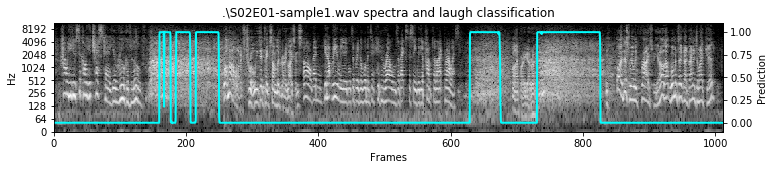

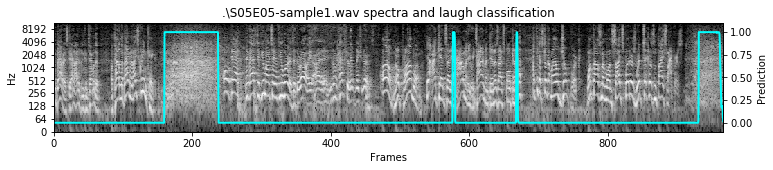

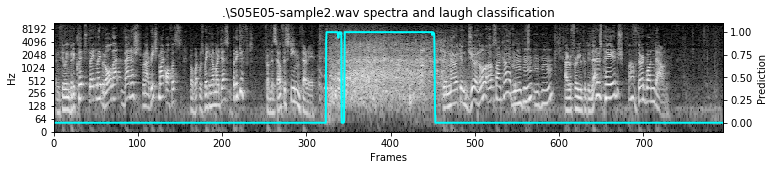

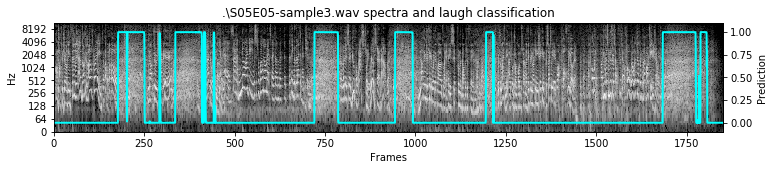

In [14]:
for f in glob('./S*sample?.wav'):
    predict_graph_clip(f, model)

Since the spectra data is typically easy for a human to classify as laugher (dense "static" sections), we can visually see that the model performs reasonably well compared to human observation.

Smoothing and more training may improve the results.  Let's train the model with our larger dataset, and then visually compare again.

### Training with more data

We previously loaded `ds2` with additional labelled examples, and then used the `ds2.idx_test` to evaluate our current model.

Now, let's use the `ds2` dataset (larger than `ds`) to train our model.

In [15]:
result = model.fit(ds2.X[ds2.idx_train], ds2.Y_class[ds2.idx_train], epochs=4, batch_size=16)

Epoch 1/4
27737/27737 [==============================] - 55s 2ms/step - loss: 0.0321 - acc: 0.9940
Epoch 2/4
27737/27737 [==============================] - 55s 2ms/step - loss: 0.0055 - acc: 0.9988
Epoch 3/4
27737/27737 [==============================] - 55s 2ms/step - loss: 0.0079 - acc: 0.9993
Epoch 4/4
27737/27737 [==============================] - 56s 2ms/step - loss: 0.0045 - acc: 0.9993


In [16]:
model.evaluate(ds2.X[ds2.idx_cv], ds2.Y_class[ds2.idx_cv])

9245/9245 [==============================] - 5s 533us/step


[1.9710022158356993e-05, 1.0]

In [17]:
model.save('method5a-trained-all.h5')

As before, let's visually examine the predictions on the sample clips:

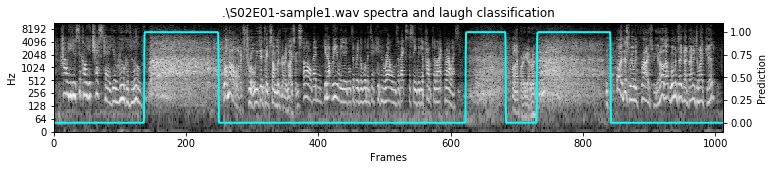

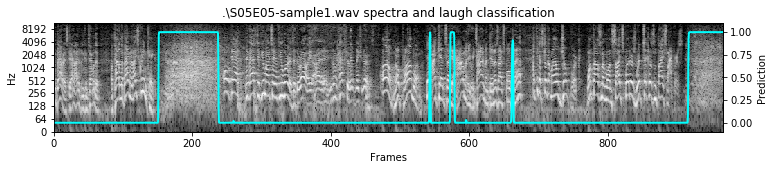

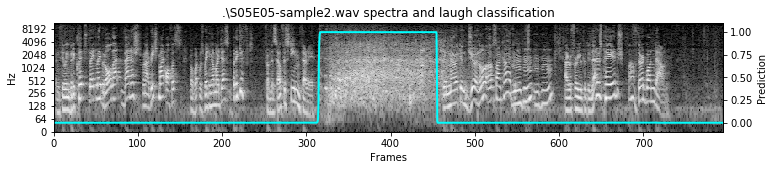

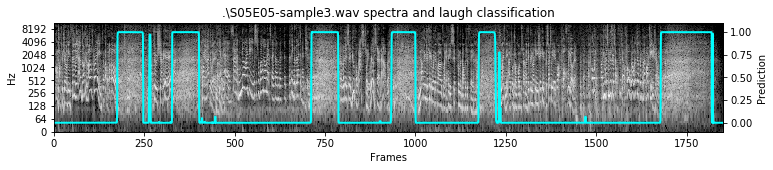

In [18]:
for f in glob('./S*sample?.wav'):
    predict_graph_clip(f, model)

To me, I see this as improvement.  For example, look at S05E05-sample2 - in the previous visualization, a chunk of what appears to be laugher was classified as not-laugher.  When applied as an audio level transformation, the hiccup would probably cause an unpleasant listening experience where a bit of canned laugher was audible for a moment.  In our current model, the entire laughtrack section would be muted out, which is preferred.

### Using the model's predictions to remove laugher from the audio

The final step: Using the model's predictions to mute the track's canned laughter sections.

The class `LaughRemover` supports loading an existing Keras model, analyzing and transforming the audio data using our `RawClip3` class, and finally saving the output to a new file.

In "production", `ffmpeg` is used to apply the updated audio to the original video clip, thus completing the project.

In [19]:
class LaughRemover(object):
    def __init__(self, kerasModel=None, kerasModelFile=None):
        assert kerasModel or kerasModelFile
        if kerasModel:
            self.model = kerasModel
        elif kerasModelFile:
            self.model = keras.models.load_model(filepath=kerasModelFile)

    def remove_laughs(self, infile, outfile):
        rc = RawClip3(infile)
        rc.laughs = self.model.predict(rc.build_features())
        self._apply_laughs_array(rc.y, rc.sr, outfile, rc.laughs[:, 1])
        return rc

    def _apply_laughs_array(self, y, sr, outfile, laughs):
        y.T[0] = self._apply_frames_to_samples(frames=laughs, samples=y.T[0])
        y.T[1] = self._apply_frames_to_samples(frames=laughs, samples=y.T[1])
        sf.write(outfile, y, sr)

    def _apply_frames_to_samples(self, frames, samples, exp=1, period=15):
        # Apply a rolling average to smooth the laugh/notlaugh sections
        frames = np.convolve(frames, np.ones((period,))/period, mode='same')
        # Each frame = default 512 samples, so expand over that period
        frames = np.repeat(frames, librosa.core.frames_to_samples(1))
        # Trim excess padding off the rightmost end
        frames = frames[:len(samples)]
        # Finally, apply audio volume change
        return samples * (frames ** exp)


In [20]:
laughr = LaughRemover(kerasModel=model)

laughr.remove_laughs('S05E05-sample3.wav', 'S05E05-sample3-method5a-output.wav')

In [21]:
from IPython.display import Audio

Audio('S05E05-sample3.wav')

In [22]:
Audio('S05E05-sample3-method5a-output.wav')

You can listen to the two audio clips to hear the model removing the laugh track from the clip.

Now, to do this for a full-length episode:

In [23]:
laughr.remove_laughs('training/set2/S05E14.wav', 'training/set2/S05E14-method5a-output.wav')

Outside of this notebook, I used ffmpeg to combine the audio:

`ffmpeg -i S05E14.avi -i S05E14-method5a-output.wav -map 0:0 -map 1:0 -c:v copy -c:a aac -b:a 256k -shortest S05E14-method5a.mp4`

#### Additional Notes and Next Steps

I did some work to visualize the features over time, and as a result suspect that dropping several of the features would not compromise performance of the model.  This would likely speed up processing speed.

I also did work to embed the features visualization as a video overlay onto the original clips, allowing watching the video with a picture-in-picture graph showing the input features send to the model, sync'd to the time of the video.

Add more training data - always a good idea.

When listening to the results, dropping out the background noise entirely (muting the laugh track) is a bit jarring.  It might be a good idea to create a composite "noise" audio track to mix back in, thus keeping a sense of continuity.

Another idea - use this as a helper tool in a manual pipeline, much like the Photoshop magic wand.  One approach: convert the prediction output to volume envelope data for use in Audacity.  This would allow a manual operator to review and adjust the tweaks, while allowing the automated tool to do a first-pass at clipping out the laugher.
